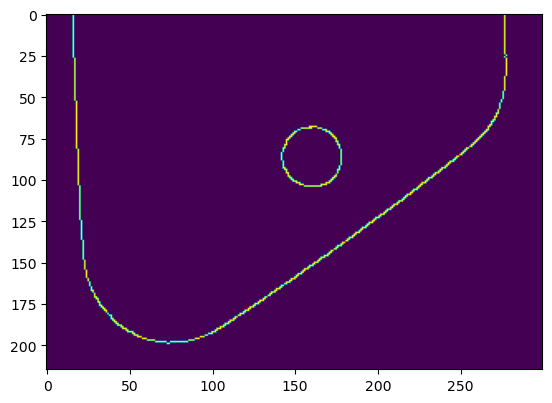

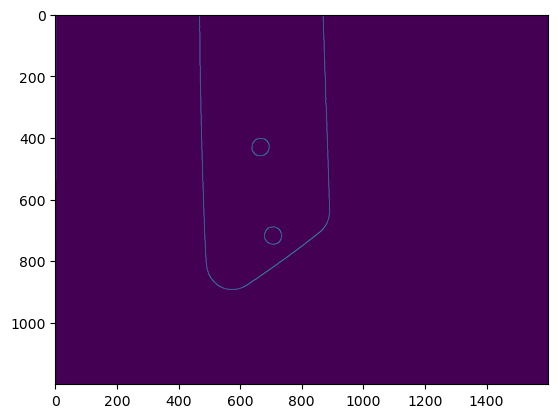

In [103]:
'''
Fork-tip key point detection with Mask R-CNN 
'''
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

patch = cv2.imread("./data/fork_patch.png")
patch_gray = cv2.cvtColor(patch, cv2.COLOR_RGB2GRAY)

patch_blur = cv2.GaussianBlur(patch_gray, (3, 3), 0)
patch_gray = cv2.Canny(patch_blur, 10, 120)

#patch_canny = cv2.Canny(patch_gray, 10, 150) #canny edge
#patch_laplacian = cv2.Laplacian(patch_gray, cv2.CV_8UC1, ksize=5) #laplacian edge
#patch_sobel = cv2.Sobel(patch_gray,cv2.CV_8UC1, 1, 1) # sobel edge
plt.clf()
plt.imshow(patch_gray)
plt.show()

map = cv2.imread("./data/fork_map.png")
map_gray = cv2.cvtColor(map, cv2.COLOR_RGB2GRAY)
map_blur = cv2.GaussianBlur(map_gray, (5, 5), 0)
map_gray = cv2.Canny(map_blur, 10, 120)

plt.imshow(map_gray)
plt.show()


(-0.5, 1599.5, 1199.5, -0.5)

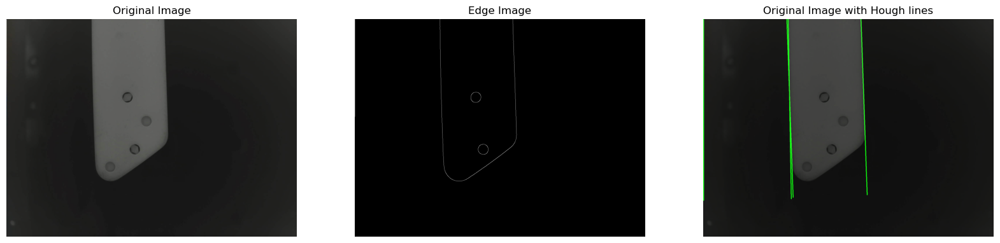

In [106]:
# Draw the lines represented in the hough accumulator on the original image
def drawhoughLinesOnImage(image, houghLines):
    for line in houghLines:
        for rho,theta in line:
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a*rho
            y0 = b*rho
            x1 = int(x0 + 1000*(-b))
            y1 = int(y0 + 1000*(a))
            x2 = int(x0 - 1000*(-b))
            y2 = int(y0 - 1000*(a))
            
            cv2.line(image,(x1,y1),(x2,y2),(0,255,0), 3)   

# Different weights are added to the image to give a feeling of blending
def blend_images(image, final_image, alpha=0.7, beta=1., gamma=0.):
    return cv2.addWeighted(final_image, alpha, image, beta,gamma)

# Detect points that form a line
dis_reso = 1 # Distance resolution in pixels of the Hough grid
theta = np.pi /180 # Angular resolution in radians of the Hough grid
threshold = 170# minimum no of votes

houghLines = cv2.HoughLines(map_gray, dis_reso, theta, threshold)

houghLinesImage = np.zeros_like(map) # create and empty image

drawhoughLinesOnImage(houghLinesImage, houghLines) # draw the lines on the empty image
orginalImageWithHoughLines = blend_images(houghLinesImage,map) # add two images together, using image blending

fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(20, 20))
ax1.imshow(map)
ax1.set_title('Original Image')
ax1.axis('off')

ax2.imshow(map_gray, cmap='gray')
ax2.set_title('Edge Image')
ax2.axis('off')

ax3.imshow(orginalImageWithHoughLines, cmap='gray')
ax3.set_title("Original Image with Hough lines")
ax3.axis('off')

In [170]:

map = cv2.imread("./data/fork_map.png")
map_gray = cv2.cvtColor(map, cv2.COLOR_RGB2GRAY)
map_blur = cv2.GaussianBlur(map_gray, (5, 5), 0)
map_gray = cv2.Canny(map_blur, 10, 120)
dst = cv2.goodFeaturesToTrack(map_gray, 255, 0.05, 5, blockSize=3, useHarrisDetector=True, k=0.03)


print(dst.size)
for i in dst:
    x, y, = i.ravel()
    print(tuple(i[0]))
    cv2.circle(map_gray, tuple(i[0]), 3, (0,255,0), 2)

plt.imshow(map_gray, cmap='gray')
plt.show()

136
(2.0, 2.0)


error: OpenCV(4.6.0) :-1: error: (-5:Bad argument) in function 'circle'
> Overload resolution failed:
>  - Can't parse 'center'. Sequence item with index 0 has a wrong type
>  - Can't parse 'center'. Sequence item with index 0 has a wrong type


[ WARN:0@13248.030] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@13248.030] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




> video info : (1600,1200@50.0), 494 frames


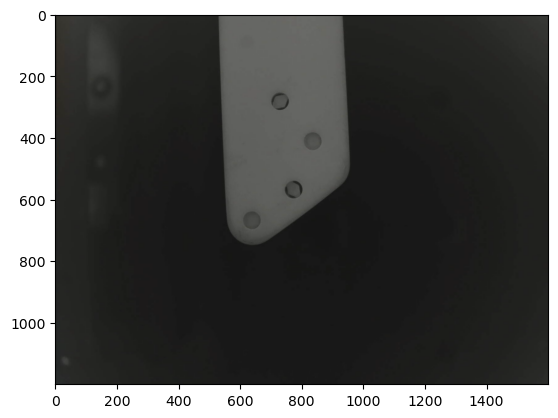

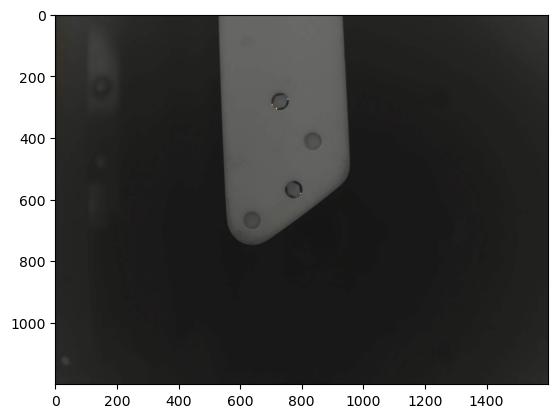

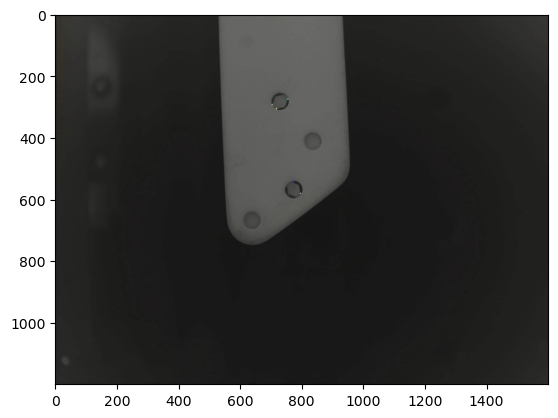

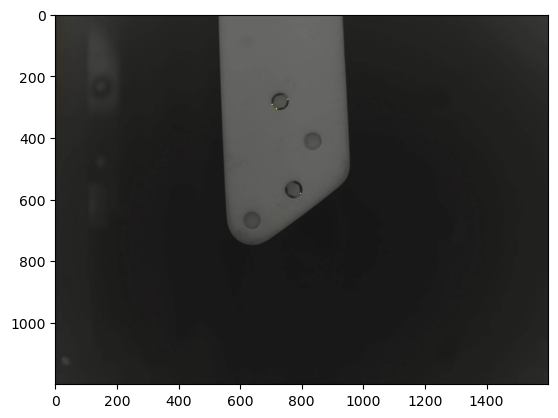

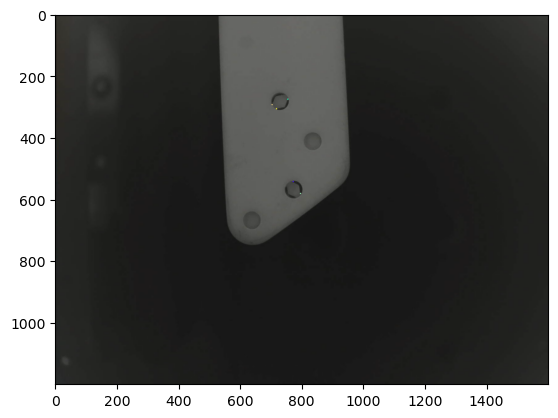

...

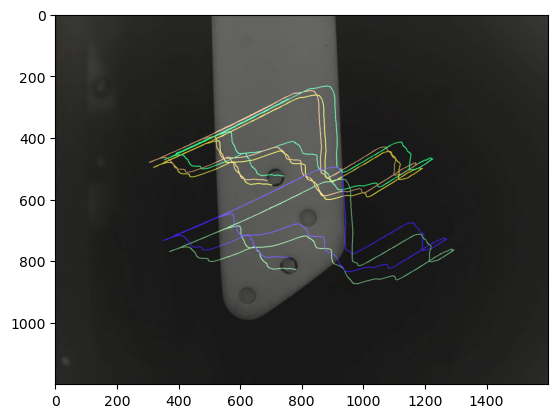

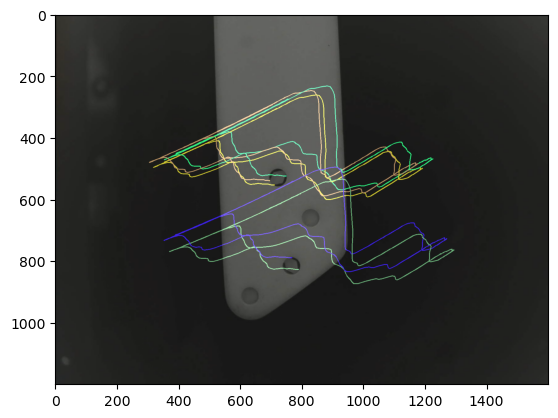

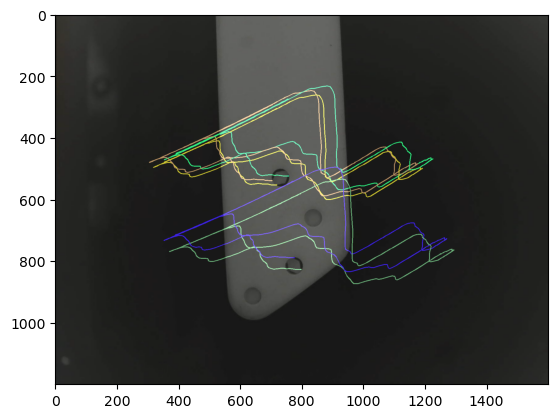

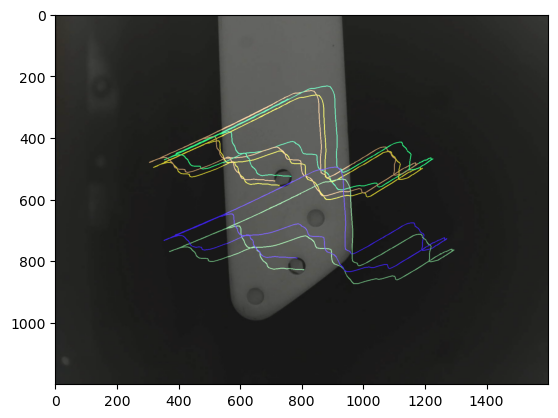

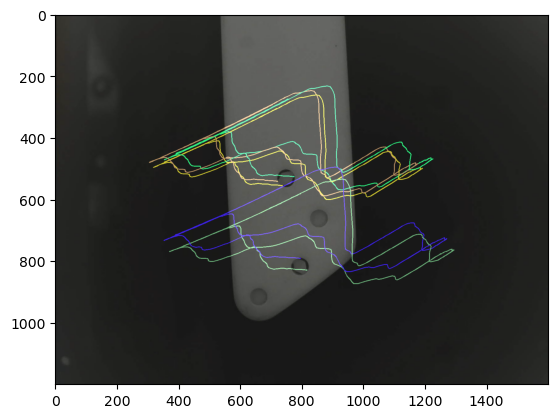

In [180]:
video = cv2.VideoCapture('./video/forktip_no_bg_10s_rotate.avi')
w  = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = video.get(cv2.CAP_PROP_FPS)
frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
print("> video info : ({},{}@{}), {} frames".format(w, h, fps, frames))

delay = int(1000/fps)
color = np.random.randint(0,255,(200,3))
termcriteria =  (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
prev_frame = None

if video.isOpened():
    while True:
        ret, frame = video.read()
        
        if not ret:
            break
        img_draw = frame.copy()

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        if prev_frame is None:
            prev_frame = gray
            lines = np.zeros_like(frame)
            prevPt = cv2.goodFeaturesToTrack(prev_frame, 200, 0.01, 10)
        else:
            next_frame = gray
            nextPt, status, err = cv2.calcOpticalFlowPyrLK(prev_frame, next_frame, prevPt, None, criteria=termcriteria)
            prevMv = prevPt[status==1]
            nextMv = nextPt[status==1]
            for i,(p, n) in enumerate(zip(prevMv, nextMv)):
                px,py = p.ravel()
                nx,ny = n.ravel()
                cv2.line(lines, (int(px),int(py)), (int(nx),int(ny)), color[i].tolist(), 2)
                cv2.circle(img_draw, (int(nx),int(ny)), 2, color[i].tolist(), -1)
            img_draw = cv2.add(img_draw, lines)
            prev_frame = next_frame
            prevPt = nextMv.reshape(-1,1,2)
        plt.imshow(img_draw)
        plt.show()
        #cv2.imshow('OpticalFlow-LK', img_draw)

video.release()